In [7]:
!pip install -q --upgrade jcopdl==1.1.10
!pip install -q luwiji

In [8]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import torch
from torch import nn, optim
from jcopdl.callback import Callback, set_config

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
device

device(type='cuda')

# Dataset & Dataloader

In [9]:
from torchvision import datasets, transforms
from torch.utils.data import DataLoader

In [13]:
BATCH_SIZE = 128
CROP_SIZE = 64 # karena input dari CNN harus selalu sama, dan idealnya standardnya menggunakan 224x224 tetapi agar running tidak lama sehingga menggunakan 64x64 

IMG_DIR = '/kaggle/input/hama-image-dataset/data/'

train_transform = transforms.Compose([
    transforms.RandomRotation(15), # rotasi 15 derajat
    transforms.RandomResizedCrop(CROP_SIZE, scale=(0.8, 1.0)), # zoom in hingga 80% dari gambar asli
    transforms.RandomHorizontalFlip(), # Flip Horizontal
    transforms.ToTensor() 
])

test_transform = transforms.Compose([
    transforms.Resize(70),# harus di-resize terlebih agar sedikit mirip dengan ukuran crop agar pemotongan gambarnya tidak terlalu kecil 
    transforms.CenterCrop(CROP_SIZE), # samakan ukuran gambar dengan train
    transforms.ToTensor() 
])

train_set = datasets.ImageFolder(IMG_DIR + 'train/', transform=train_transform)
trainloader = DataLoader(train_set, batch_size=BATCH_SIZE, shuffle=True, num_workers=2) 

test_set = datasets.ImageFolder(IMG_DIR + 'test/', transform=test_transform)
testloader = DataLoader(test_set, batch_size=BATCH_SIZE, shuffle=True) 

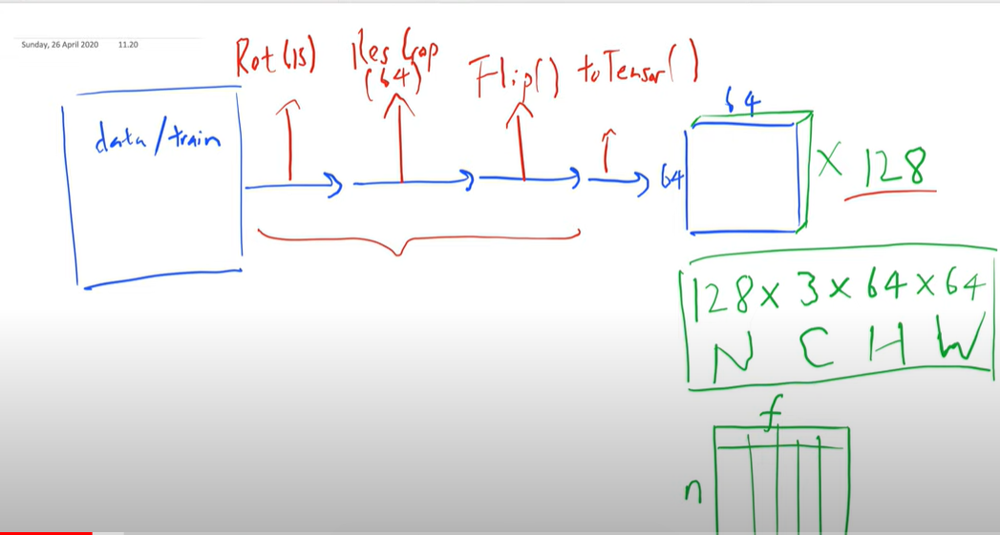

In [14]:
feature, target = next(iter(trainloader))
feature.shape

torch.Size([128, 3, 64, 64])

batch = 128 | 
channel = 3 | 
pixel = 64x64

In [15]:
label2cat = train_set.classes
label2cat

['invasive', 'noninvasive']

# Arsitektur & Config

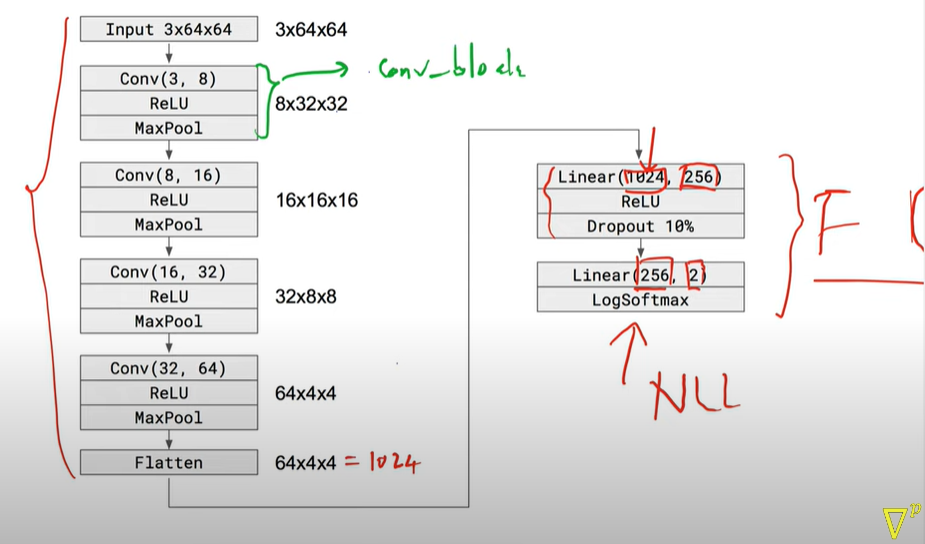

In [17]:
from jcopdl.layers import conv_block, linear_block

In [19]:
class CNN(nn.Module):
    def __init__(self):
        super().__init__()
        self.conv = nn.Sequential(
            conv_block(c_in=3, c_out=8, pool_type='maxpool', activation='relu'),
            conv_block(c_in=8, c_out=16, pool_type='maxpool', activation='relu'),
            conv_block(c_in=16, c_out=32, pool_type='maxpool', activation='relu'),
            conv_block(c_in=32, c_out=64, pool_type='maxpool', activation='relu'),
            nn.Flatten()
        )
        
        self.fc = nn.Sequential(
            linear_block(n_in=1024, n_out=256, activation='relu', dropout=0.1),
            linear_block(n_in=256, n_out=2, activation='lsoftmax')
        )
        
    def forward(self, x):
        x = self.conv(x)
        x = self.fc(x)
        return x

In [20]:
config = set_config({
    "batch_size": BATCH_SIZE,
    "crop_size": CROP_SIZE
})

# Training Preparation -> MCOC

In [21]:
model = CNN().to(device)
criterion = nn.NLLLoss()
optimizer = optim.AdamW(model.parameters(), lr=0.001)
callback = Callback(model, config=config, save_every=50, early_stop_patience=5, plot_every=20, outdir='model')

# Training

In [22]:
from tqdm.auto import tqdm

def loop_fn(mode, dataset, dataloader, model, criterion, optimizer, device):
    if mode == 'train':
        model.train()
    elif mode == 'test':
        model.eval()
    cost = correct = 0
    for feature, target in tqdm(dataloader, desc=mode.title()):
        feature, target = feature.to(device), target.to(device)
        output = model(feature)
        loss = criterion(output, target)
        
        if mode == 'train':
            loss.backward()
            optimizer.step()
            optimizer.zero_grad()
            
        cost += loss.item() * feature.shape[0]
        correct += (output.argmax(1) == target).sum().item()
    cost = cost / len(dataset)
    acc = correct / len(dataset)
    return cost, acc

Train:   0%|          | 0/8 [00:00<?, ?it/s]

Test:   0%|          | 0/4 [00:00<?, ?it/s]


Epoch     1
Train_cost  = 0.6905 | Test_cost  = 0.6839 | Train_score = 0.5200 | Test_score = 0.5025 |


Train:   0%|          | 0/8 [00:00<?, ?it/s]

Test:   0%|          | 0/4 [00:00<?, ?it/s]


Epoch     2
Train_cost  = 0.6752 | Test_cost  = 0.6496 | Train_score = 0.5970 | Test_score = 0.6600 |


Train:   0%|          | 0/8 [00:00<?, ?it/s]

Test:   0%|          | 0/4 [00:00<?, ?it/s]


Epoch     3
Train_cost  = 0.6064 | Test_cost  = 0.5363 | Train_score = 0.7090 | Test_score = 0.7675 |


Train:   0%|          | 0/8 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7cf1ac037910>
Traceback (most recent call last):
  File "/opt/conda/lib/python3.10/site-packages/torch/utils/data/dataloader.py", line 1479, in __del__
    self._shutdown_workers()
  File "/opt/conda/lib/python3.10/site-packages/torch/utils/data/dataloader.py", line 1462, in _shutdown_workers
    if w.is_alive():
  File "/opt/conda/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7cf1ac037910>
Traceback (most recent call last):
  File "/opt/conda/lib/python3.10/site-packages/torch/utils/data/dataloader.py", line 1479, in __del__
    self._shutdown_workers()
  File "/opt/conda/lib/python3.10/site-packages/torch/utils/data/dataloader.py", line 1462, in _shutdown_workers
    if w.is_alive():
  File "/op

Test:   0%|          | 0/4 [00:00<?, ?it/s]


Epoch     4
Train_cost  = 0.5163 | Test_cost  = 0.5147 | Train_score = 0.7510 | Test_score = 0.7350 |
==> EarlyStop patience =  1 | Best test_score: 0.7675


Train:   0%|          | 0/8 [00:00<?, ?it/s]

Test:   0%|          | 0/4 [00:00<?, ?it/s]


Epoch     5
Train_cost  = 0.4905 | Test_cost  = 0.4383 | Train_score = 0.7720 | Test_score = 0.8175 |


Train:   0%|          | 0/8 [00:00<?, ?it/s]

Test:   0%|          | 0/4 [00:00<?, ?it/s]


Epoch     6
Train_cost  = 0.4544 | Test_cost  = 0.4341 | Train_score = 0.7850 | Test_score = 0.7875 |
==> EarlyStop patience =  1 | Best test_score: 0.8175


Train:   0%|          | 0/8 [00:00<?, ?it/s]

Test:   0%|          | 0/4 [00:00<?, ?it/s]


Epoch     7
Train_cost  = 0.4245 | Test_cost  = 0.5474 | Train_score = 0.8080 | Test_score = 0.7200 |
==> EarlyStop patience =  2 | Best test_score: 0.8175


Train:   0%|          | 0/8 [00:00<?, ?it/s]

Test:   0%|          | 0/4 [00:00<?, ?it/s]


Epoch     8
Train_cost  = 0.4928 | Test_cost  = 0.4975 | Train_score = 0.7740 | Test_score = 0.7450 |
==> EarlyStop patience =  3 | Best test_score: 0.8175


Train:   0%|          | 0/8 [00:00<?, ?it/s]

Test:   0%|          | 0/4 [00:00<?, ?it/s]


Epoch     9
Train_cost  = 0.4528 | Test_cost  = 0.4154 | Train_score = 0.8090 | Test_score = 0.8075 |
==> EarlyStop patience =  4 | Best test_score: 0.8175


Train:   0%|          | 0/8 [00:00<?, ?it/s]

Test:   0%|          | 0/4 [00:00<?, ?it/s]


Epoch    10
Train_cost  = 0.4173 | Test_cost  = 0.3897 | Train_score = 0.8180 | Test_score = 0.8225 |


Train:   0%|          | 0/8 [00:00<?, ?it/s]

Test:   0%|          | 0/4 [00:00<?, ?it/s]


Epoch    11
Train_cost  = 0.3994 | Test_cost  = 0.4271 | Train_score = 0.8260 | Test_score = 0.8050 |
==> EarlyStop patience =  1 | Best test_score: 0.8225


Train:   0%|          | 0/8 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7cf1ac037910>
Traceback (most recent call last):
  File "/opt/conda/lib/python3.10/site-packages/torch/utils/data/dataloader.py", line 1479, in __del__
    self._shutdown_workers()
  File "/opt/conda/lib/python3.10/site-packages/torch/utils/data/dataloader.py", line 1462, in _shutdown_workers
    if w.is_alive():
  File "/opt/conda/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7cf1ac037910>
Traceback (most recent call last):
  File "/opt/conda/lib/python3.10/site-packages/torch/utils/data/dataloader.py", line 1479, in __del__
    self._shutdown_workers()
  File "/opt/conda/lib/python3.10/site-packages/torch/utils/data/dataloader.py", line 1462, in _shutdown_workers
    if w.is_alive():
  File "/op

Test:   0%|          | 0/4 [00:00<?, ?it/s]


Epoch    12
Train_cost  = 0.3972 | Test_cost  = 0.3773 | Train_score = 0.8160 | Test_score = 0.8325 |


Exception ignored in: 

Train:   0%|          | 0/8 [00:00<?, ?it/s]

<function _MultiProcessingDataLoaderIter.__del__ at 0x7cf1ac037910>
Traceback (most recent call last):
  File "/opt/conda/lib/python3.10/site-packages/torch/utils/data/dataloader.py", line 1479, in __del__
    self._shutdown_workers()
  File "/opt/conda/lib/python3.10/site-packages/torch/utils/data/dataloader.py", line 1462, in _shutdown_workers
    if w.is_alive():
  File "/opt/conda/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7cf1ac037910>
Traceback (most recent call last):
  File "/opt/conda/lib/python3.10/site-packages/torch/utils/data/dataloader.py", line 1479, in __del__
Exception ignored in:     <function _MultiProcessingDataLoaderIter.__del__ at 0x7cf1ac037910>self._shutdown_workers()

Traceback (most recent call last):
  File "/opt/conda/lib/python3.10/site-pac

Test:   0%|          | 0/4 [00:00<?, ?it/s]


Epoch    13
Train_cost  = 0.3798 | Test_cost  = 0.3809 | Train_score = 0.8350 | Test_score = 0.8275 |
==> EarlyStop patience =  1 | Best test_score: 0.8325


Train:   0%|          | 0/8 [00:00<?, ?it/s]

Test:   0%|          | 0/4 [00:00<?, ?it/s]


Epoch    14
Train_cost  = 0.3761 | Test_cost  = 0.3630 | Train_score = 0.8320 | Test_score = 0.8425 |


Train:   0%|          | 0/8 [00:00<?, ?it/s]

Test:   0%|          | 0/4 [00:00<?, ?it/s]


Epoch    15
Train_cost  = 0.3777 | Test_cost  = 0.4332 | Train_score = 0.8430 | Test_score = 0.7900 |
==> EarlyStop patience =  1 | Best test_score: 0.8425


Train:   0%|          | 0/8 [00:00<?, ?it/s]

Test:   0%|          | 0/4 [00:00<?, ?it/s]


Epoch    16
Train_cost  = 0.3789 | Test_cost  = 0.4180 | Train_score = 0.8340 | Test_score = 0.8100 |
==> EarlyStop patience =  2 | Best test_score: 0.8425


Train:   0%|          | 0/8 [00:00<?, ?it/s]

Test:   0%|          | 0/4 [00:00<?, ?it/s]


Epoch    17
Train_cost  = 0.3686 | Test_cost  = 0.3920 | Train_score = 0.8430 | Test_score = 0.8300 |
==> EarlyStop patience =  3 | Best test_score: 0.8425


Train:   0%|          | 0/8 [00:00<?, ?it/s]

Test:   0%|          | 0/4 [00:00<?, ?it/s]


Epoch    18
Train_cost  = 0.3608 | Test_cost  = 0.3610 | Train_score = 0.8440 | Test_score = 0.8400 |
==> EarlyStop patience =  4 | Best test_score: 0.8425


Train:   0%|          | 0/8 [00:00<?, ?it/s]

Test:   0%|          | 0/4 [00:00<?, ?it/s]


Epoch    19
Train_cost  = 0.3506 | Test_cost  = 0.3654 | Train_score = 0.8540 | Test_score = 0.8475 |


Train:   0%|          | 0/8 [00:00<?, ?it/s]

Test:   0%|          | 0/4 [00:00<?, ?it/s]


Epoch    20
Train_cost  = 0.3409 | Test_cost  = 0.3467 | Train_score = 0.8580 | Test_score = 0.8500 |


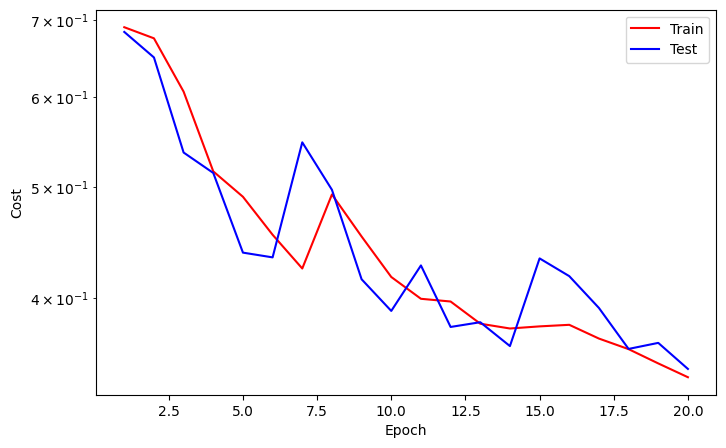

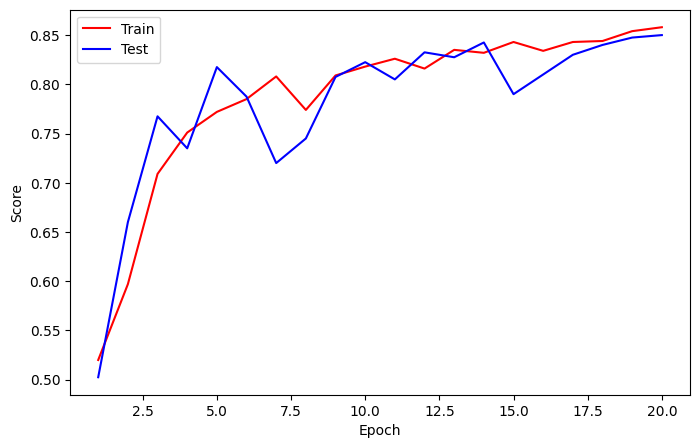

Train:   0%|          | 0/8 [00:00<?, ?it/s]

IOStream.flush timed out


Test:   0%|          | 0/4 [00:00<?, ?it/s]


Epoch    21
Train_cost  = 0.3414 | Test_cost  = 0.3392 | Train_score = 0.8480 | Test_score = 0.8450 |
==> EarlyStop patience =  1 | Best test_score: 0.8500


Train:   0%|          | 0/8 [00:00<?, ?it/s]

Test:   0%|          | 0/4 [00:00<?, ?it/s]


Epoch    22
Train_cost  = 0.3432 | Test_cost  = 0.3746 | Train_score = 0.8550 | Test_score = 0.8300 |
==> EarlyStop patience =  2 | Best test_score: 0.8500


Train:   0%|          | 0/8 [00:00<?, ?it/s]

Test:   0%|          | 0/4 [00:00<?, ?it/s]


Epoch    23
Train_cost  = 0.3447 | Test_cost  = 0.3398 | Train_score = 0.8450 | Test_score = 0.8475 |
==> EarlyStop patience =  3 | Best test_score: 0.8500


Train:   0%|          | 0/8 [00:00<?, ?it/s]

Test:   0%|          | 0/4 [00:00<?, ?it/s]


Epoch    24
Train_cost  = 0.3370 | Test_cost  = 0.3296 | Train_score = 0.8540 | Test_score = 0.8475 |
==> EarlyStop patience =  4 | Best test_score: 0.8500


Train:   0%|          | 0/8 [00:00<?, ?it/s]

Test:   0%|          | 0/4 [00:00<?, ?it/s]


Epoch    25
Train_cost  = 0.3708 | Test_cost  = 0.3746 | Train_score = 0.8490 | Test_score = 0.8450 |
==> EarlyStop patience =  5 | Best test_score: 0.8500
==> Execute Early Stopping at epoch: 25 | Best test_score: 0.8500
==> Best model is saved at model


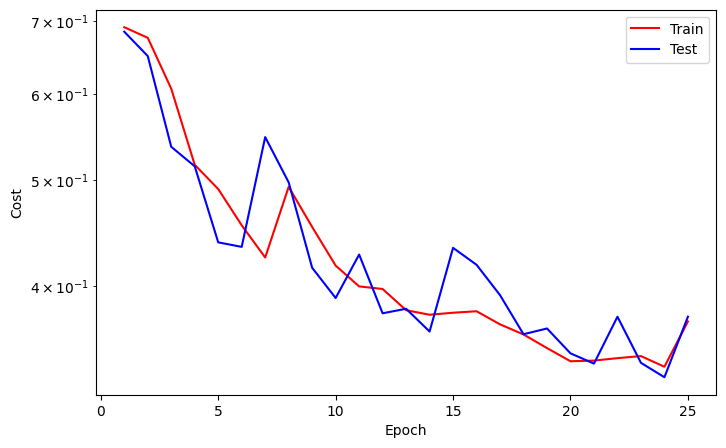

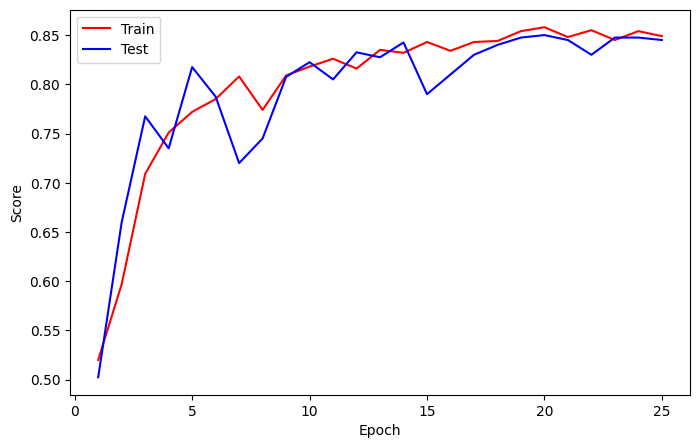

In [23]:
while True:
    train_cost, train_score = loop_fn('train', train_set, trainloader, model, criterion, optimizer, device)
    with torch.no_grad():
        test_cost, test_score = loop_fn('test', test_set, testloader, model, criterion, optimizer, device)
        
    # Logging and Reporting
    callback.log(train_cost, test_cost, train_score, test_score)

    # Checkpoint
    callback.save_checkpoint()

#     # Runtime Plotting
    callback.cost_runtime_plotting()
    callback.score_runtime_plotting()

    # Early Stopping
    if callback.early_stopping(model, monitor='test_score'): 
        callback.plot_cost()
        callback.plot_score()
        break

# Predict

In [24]:
feature, target = next(iter(testloader))
feature, target = feature.to(device), target.to(device)

In [25]:
with torch.no_grad():
    model.eval()
    output = model(feature)
    preds = output.argmax(1)
preds

tensor([1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1,
        0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0,
        0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0,
        0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1,
        1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1,
        1, 0, 1, 0, 0, 1, 0, 0], device='cuda:0')

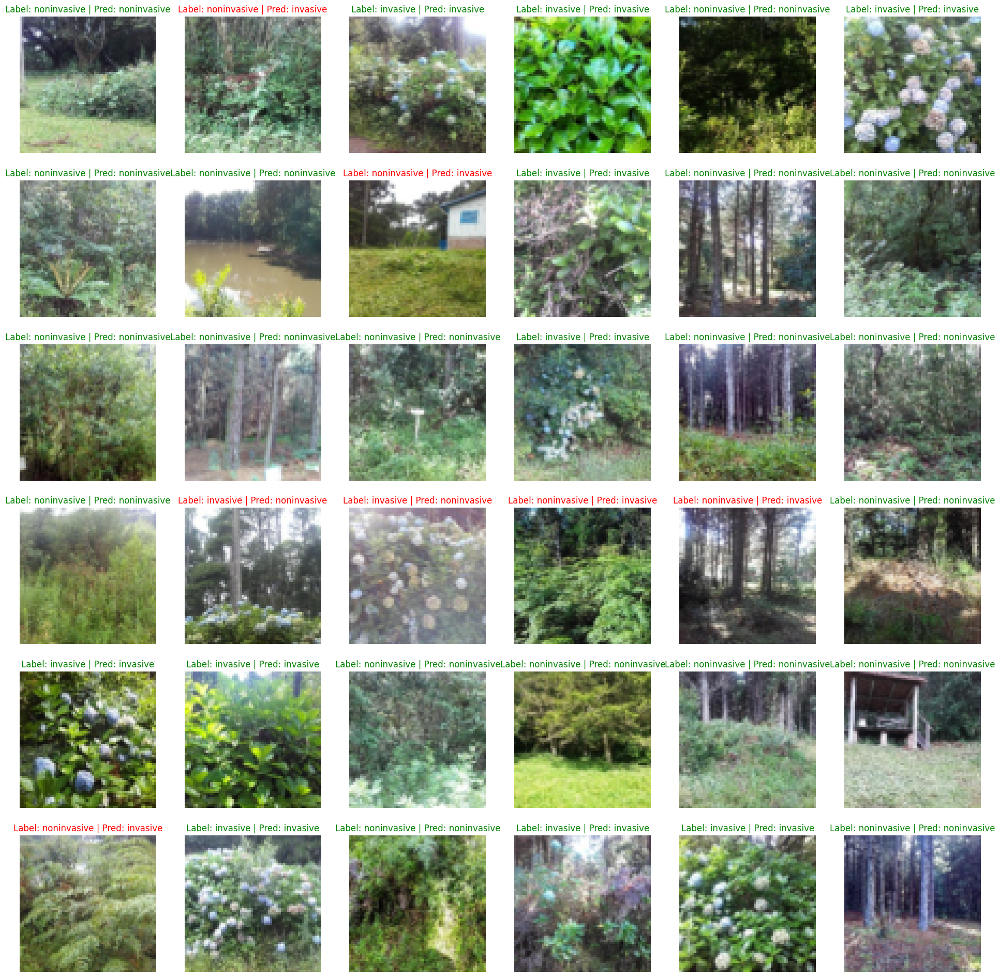

In [27]:
fig, axes = plt.subplots(6, 6, figsize=(24, 24))
for img, label, pred, ax in zip(feature, target, preds, axes.flatten()):
    ax.imshow(img.permute(1, 2, 0).cpu())
    font = {"color": "g"} if label == pred else {"color": "r"}
    label, pred = label2cat[label.item()], label2cat[pred.item()]
    ax.set_title(f"Label: {label} | Pred: {pred}", fontdict=font)
    ax.axis('off');

# Gambar Hama Hydrangea Asi

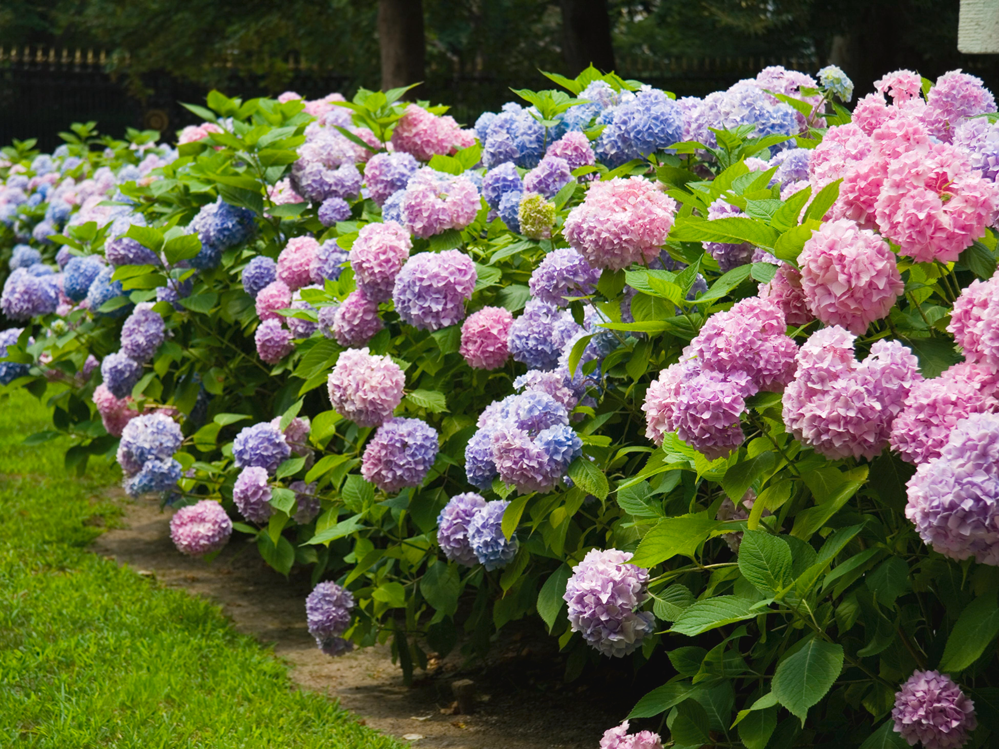

## Tambahan Perbedaan (Optional)
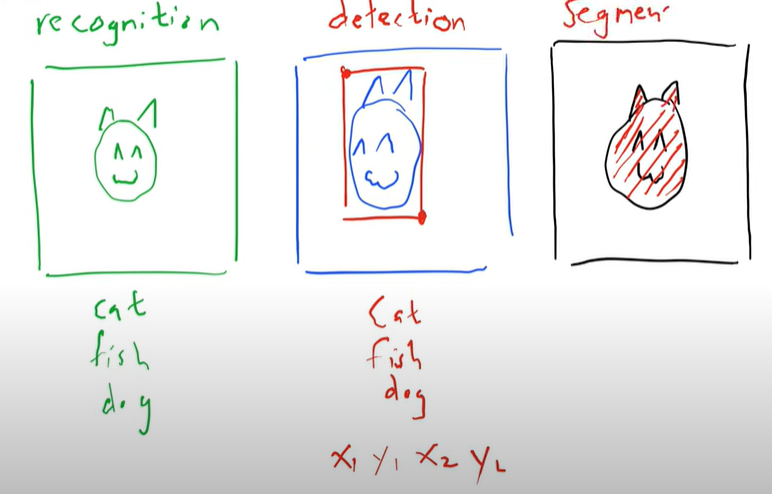